TAREA 2: Visualizacion de datos 2024-1 
- Nombre: Nicolas Esteban Parra Garcia  
- Matricula: 2019422588

# Load data

## Imports

In [1]:
import pandas as pd
import plotly.express as px
from pywaffle import Waffle
import matplotlib.pyplot as plt
import numpy as np
import os

## DataFrames 

In [2]:
# df_gapminder para las preguntas 1, 2 y 3
df_gapminder = pd.read_csv('gapminderData2.csv')
# df_migrantes_chile para la pregunta 4 y 5
df_migrantes_chile = pd.read_excel('MigrantesChile (2005-2016).xlsx',
                      sheet_name='Migrantes',
                      skipfooter=3)
# df_songs para la pregunta 6
directory_path = 'archive/'
csv_files = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith('.csv')]
dataframes = []
for file in csv_files:
    df = pd.read_csv(file)
    dataframes.append(df)
df_songs = pd.concat(dataframes, ignore_index=True)

# Pregunta 1
A partir del dataset (A), obtenga un scatterplot que permita visualizar la relaciön entre PIB per Cåpita y Nacimientospor Mujer, en el año 2007.

In [3]:
df_2007 = df_gapminder[df_gapminder['year'] == 2007]
fig = px.scatter(df_2007, x='gdpPercap', y='bornPerwom', color='continent',
                 hover_name='country', 
                 log_x=True,
                 labels={
                     "gdpPercap": "PIB per Cápita",
                     "bornPerwom": "Nacimientos por Mujer"
                 },
                 title="Relación entre PIB per Cápita y Nacimientos por Mujer en 2007")

fig.show()

# Pregunta 2

In [4]:
fig = px.scatter(df_2007, x='gdpPercap', y='bornPerwom', color='continent',
                 size='pop', hover_name='country', 
                 log_x=True, size_max=60,
                 labels={
                     "gdpPercap": "PIB per Cápita",
                     "bornPerwom": "Nacimientos por Mujer"
                 },
                 title="Relación entre PIB per Cápita y Nacimientos por Mujer en 2007 (con tamaño de burbuja )")

fig.show()

# Pregunta 3
Con plotly queda super facil.

In [5]:
fig = px.scatter(df_gapminder, x='gdpPercap', y='bornPerwom', color='continent',
                 size='pop', hover_name='country', 
                 log_x=True, size_max=60,
                 animation_frame='year', 
                 labels={
                     "gdpPercap": "PIB per Cápita",
                     "bornPerwom": "Nacimientos por Mujer"
                 },
                 title="Relación entre PIB per Cápita y Nacimientos por Mujer a través de los años")

fig.show()

# Pregunta 4

In [6]:
df_migrantes_chile.head()
df_chi = df_migrantes_chile.drop(columns=['ID Continent', 'ID Country'])

df_chi['Total'] = df_chi.select_dtypes(include=['number']).sum(axis=1)
df_chi_europe = df_chi[df_chi['Continent'] == 'Europe']
df_chi_europe = df_chi_europe.sort_values(by='Total', ascending=False).head(8)

fig = px.treemap(df_chi_europe, path=['Country'], values='Total',
                 title='Number of Migrants from Top 8 European Countries in Chile')

fig.show()

# Pregunta 5

In [7]:
df_chi_europe_top5 = df_chi_europe.head(5)
df_pivot = df_chi_europe_top5.melt(id_vars='Country', var_name='Year', value_name='Immigrants')
df_pivot = df_pivot.pivot(index='Year', columns='Country', values='Immigrants')

# Create the heatmap
fig = px.imshow(df_pivot, 
                labels=dict(x="Country", y="Year", color="Number of Immigrants"),
                title='Number of Immigrants from Top 5 European Countries in Chile by Year')

fig.show()

In [8]:
df_chi_europe_top5 = df_chi_europe.head(5)

df_pivot = df_chi_europe_top5.melt(id_vars='Country', var_name='Year', value_name='Immigrants')
df_pivot = df_pivot.pivot(index='Year', columns='Country', values='Immigrants')


df_pivot = df_pivot.apply(pd.to_numeric, errors='coerce')
df_pivot.replace(0, 1e-9, inplace=True) 

log_df_pivot = np.log10(df_pivot)
fig = px.imshow(log_df_pivot, 
                labels=dict(x="Country", y="Year", color="Log of Number of Immigrants"),
                title='Log scale Number of Immigrants from Top 5 European Countries in Chile by Year',
                color_continuous_scale='Viridis')

fig.update_traces(text=df_pivot.applymap(lambda x: f'{x:.2f}'),
                  texttemplate="%{text}")

fig.show()

C:\Users\Nispe\AppData\Local\Temp\ipykernel_15500\2260241458.py:16: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



# Pregunta 6

In [9]:

df_lyrics = df_songs[['track_title','lyric']]
df_lyrics.head(2)


,track_title,lyric
0,Tim McGraw,He said the way my blue eyes shined
1,Tim McGraw,Put those Georgia stars to shame that night


In [10]:
# import pandas as pd
# import plotly.graph_objs as go
# from wordcloud import WordCloud
# import matplotlib.pyplot as plt
# from io import BytesIO
# import base64

# # Example DataFrame
# # df_song = pd.DataFrame({
# #     'album_name': ['Taylor Swift', 'Taylor Swift'],
# #     'track_title': ['Tim McGraw', 'Tim McGraw'],
# #     'track_n': [1, 1],
# #     'lyric': ['He said the way my blue eyes shined', 'Put those Georgia stars to shame that night'],
# #     'line': [1, 2]
# # })

# # Group by 'track_title' and combine lyrics
# grouped = df_songs.groupby('track_title')['lyric'].apply(' '.join).reset_index()

# # Function to convert plot to image and display in Plotly
# def plot_to_image(fig):
#     buf = BytesIO()
#     fig.savefig(buf, format="png")
#     plt.close(fig)
#     buf.seek(0)
#     string = base64.b64encode(buf.read())
#     return "data:image/png;base64," + string.decode('utf-8')

# # Loop through each song and create a word cloud
# images = []
# for index, row in grouped.iterrows():
#     # Generate word cloud
#     wordcloud = WordCloud(width = 800, height = 400, background_color ='white').generate(row['lyric'])
    
#     # Convert matplotlib figure to image
#     fig, ax = plt.subplots(figsize=(10, 5))
#     ax.imshow(wordcloud, interpolation='bilinear')
#     ax.axis('off')
#     img = plot_to_image(fig)
    
#     # Append image to list for display in Plotly
#     images.append(go.Image(source=img))

# # Create figure to display images
# fig = go.Figure(data=images)
# fig.update_layout(title_text="Word Clouds for Each Song")
# fig.show()


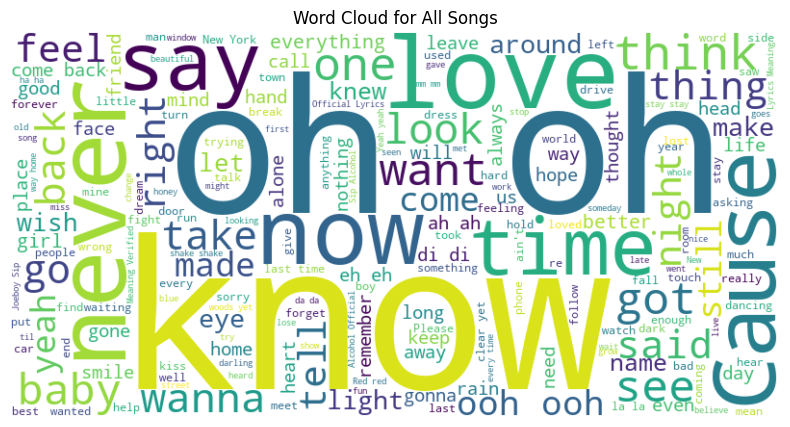

In [19]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming 'df_songs' is your DataFrame with the song data
# Example DataFrame setup
# df_songs = pd.DataFrame({
#     'album_name': ['Taylor Swift', 'Taylor Swift'],
#     'track_title': ['Tim McGraw', 'Another Song'],
#     'track_n': [1, 2],
#     'lyric': ['He said the way my blue eyes shined', 'Put those Georgia stars to shame that night'],
#     'line': [1, 2]
# })

# Combine all lyrics from all songs
all_lyrics = ' '.join(df_songs['lyric'])

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_lyrics)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title("Word Cloud for All Songs")
plt.axis('off')
plt.show()


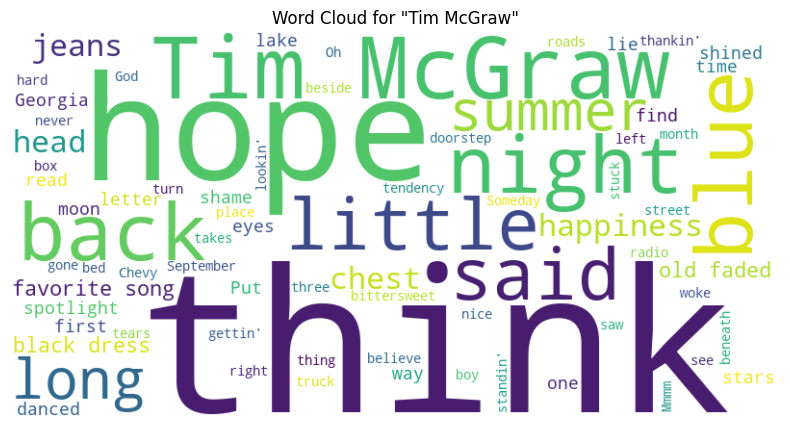

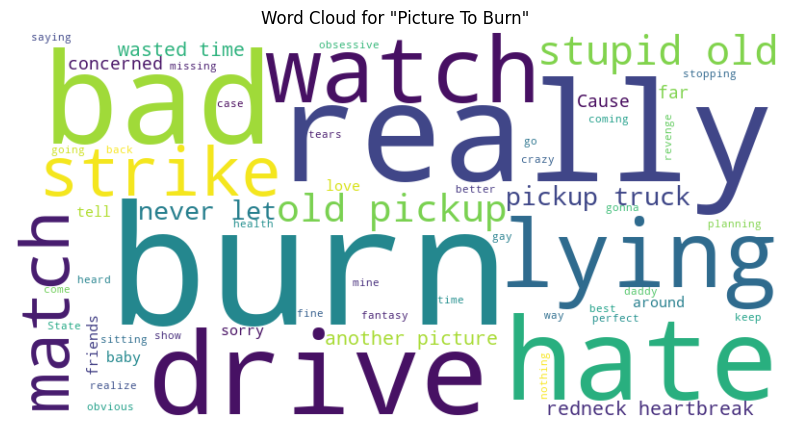

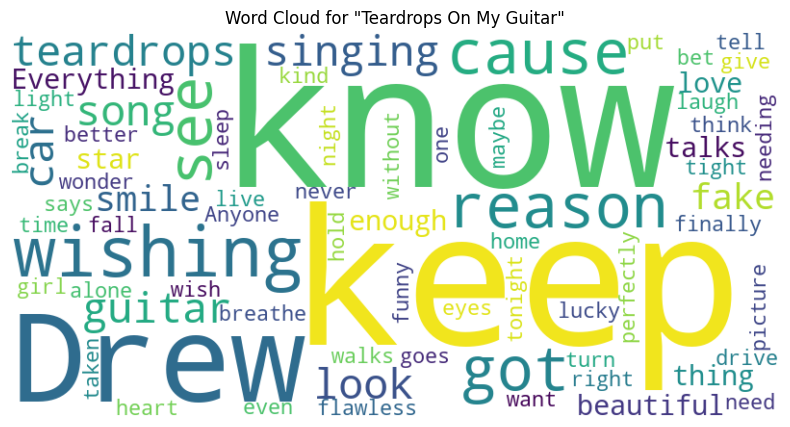

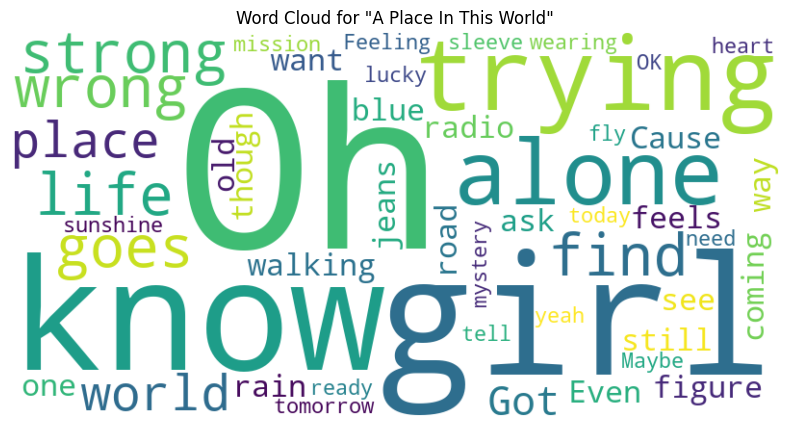

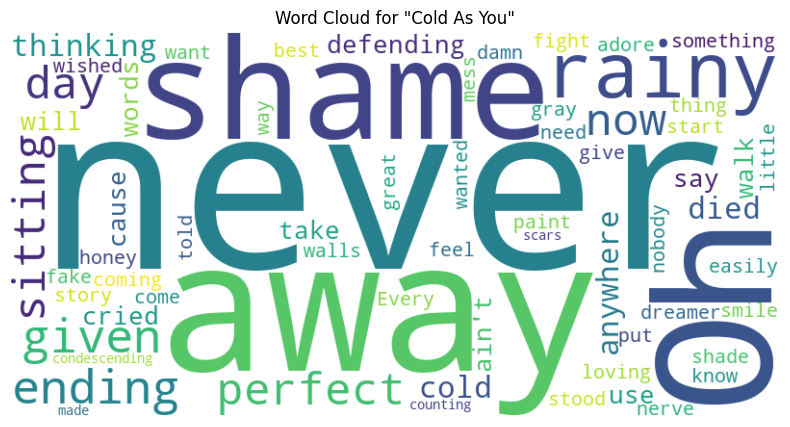

...

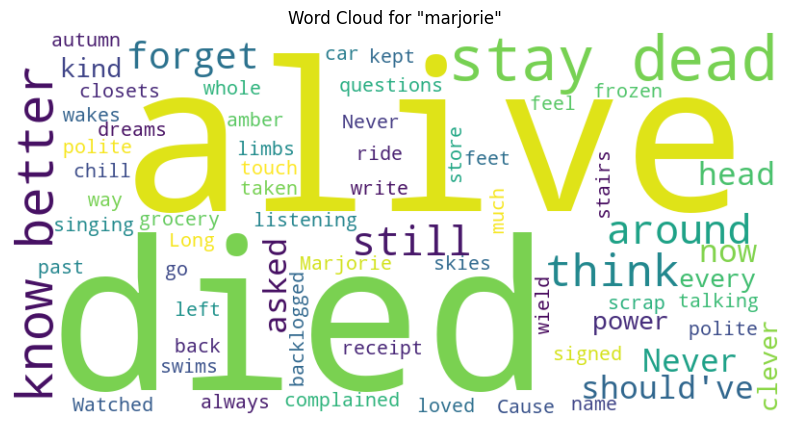

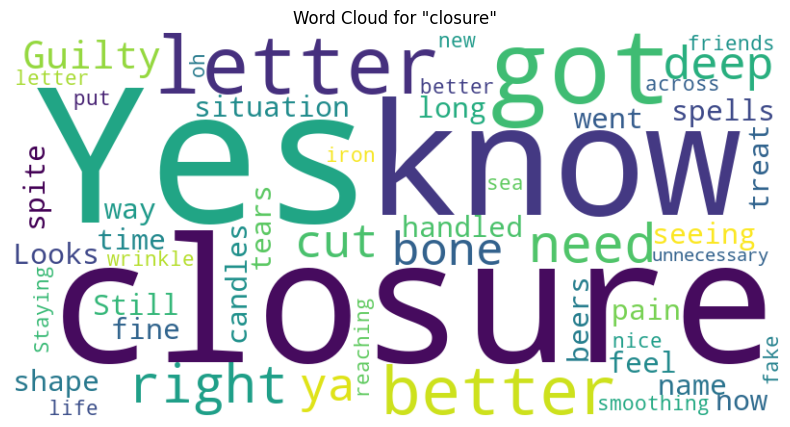

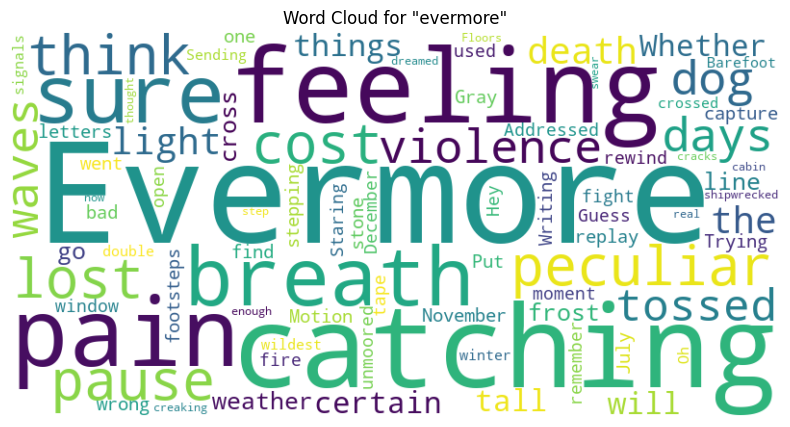

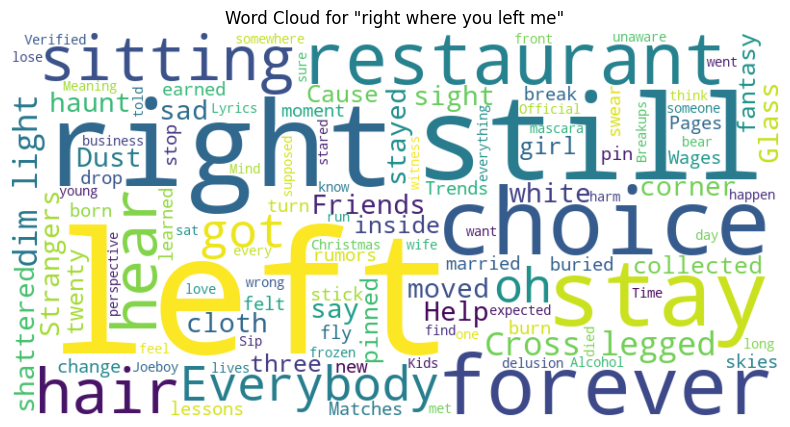

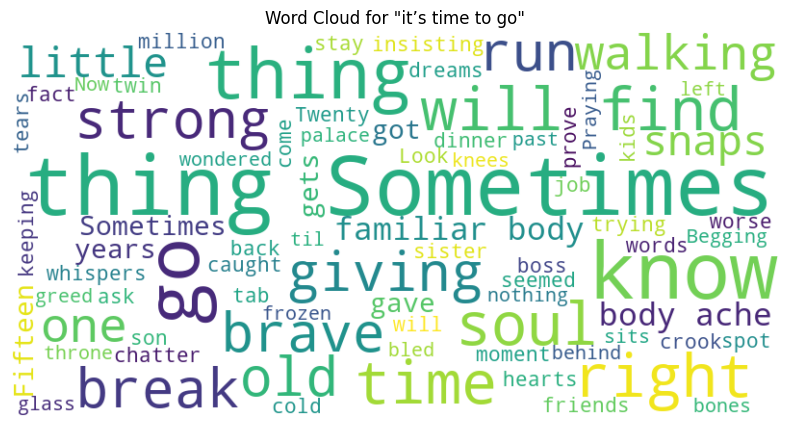

In [18]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Get unique song titles
unique_songs = df_songs['track_title'].unique()

# Generate and display a word cloud for each song
for song in unique_songs:
    # Combine all lyrics for the song
    lyrics = ' '.join(df_songs[df_songs['track_title'] == song]['lyric'])

    # Generate the word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(lyrics)

    # Display the word cloud using matplotlib
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for "{song}"')
    plt.axis('off')
    plt.show()
